In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import openpyxl
from google.colab import drive

#Visualization
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

#map
import folium
from folium.plugins import MarkerCluster


In [ ]:
# Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Define the base path and data path
base_path = '/content/drive/Shared drives/Deloitte'
data_path = base_path + '/Cleaned Data'

df_eda = pd.read_csv(data_path + "/merged_cleaned.csv")

df_eda.head()

output_dir = '/content/drive/Shared drives/Deloitte/Cleaned Data'


Mounted at /content/drive


In [ ]:
print(df_eda.dtypes)


distance                          float64
city                               object
store_size                        float64
free_wifi                            bool
parking                              bool
latitude                          float64
longitude                         float64
date_opening                       object
id                                float64
sales_representative_latitude     float64
sales_representative_longitude    float64
sales_representative_id             int64
store_size_category                 int64
opening_hour                        int64
closing_hour                        int64
customer_category                  object
distance_rep_cust_km              float64
rating                            float64
number_of_reviews                 float64
sales_amount                      float64
number_of_employees               float64
population                          int64
young_population                    int64
gdp_per_capita                    

In [ ]:
print(df_eda.shape)

(9632, 27)


In [ ]:
df_eda

,distance,city,store_size,free_wifi,parking,latitude,longitude,date_opening,id,sales_representative_latitude,...,rating,number_of_reviews,sales_amount,number_of_employees,population,young_population,gdp_per_capita,unemployment_rate,days_active,open_duration_hours
0,31.681670,A Coruña,122.1635,True,False,43.351256,-8.410301,2020-02-17,2.0,43.362927,...,4.140,13.0,38363.039529,29.000000,246047,29526,21898,0.1092,1413,7.0
1,29.656813,Bilbao,71.1614,True,True,43.255756,-2.939133,2019-04-15,3.0,43.262941,...,3.916,22.0,26352.777120,36.000000,353187,27195,28618,0.0928,1721,12.0
2,31.277988,Alicante,75.7135,True,False,38.354208,-0.505718,2019-04-17,4.0,38.300530,...,3.803,33.0,27910.264616,26.000000,33441,6153,17405,0.1413,1719,12.0
3,38.071841,Madrid,215.2493,True,True,40.463496,-3.635538,2019-04-05,5.0,40.453918,...,3.958,47.0,33478.441029,31.000000,3273049,209475,29576,0.1018,1731,17.0
4,38.649910,Caceres,252.1306,False,False,39.472037,-6.371697,2018-06-15,6.0,39.474834,...,4.932,46.0,33487.927742,29.000000,387805,36668,20354,0.1478,2025,17.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9627,35.362156,Madrid,45.0565,False,True,40.399515,-3.696936,2018-09-01,9994.0,40.403571,...,4.966,60.0,30884.234842,30.053254,3273049,209475,29576,0.1018,1947,12.0
9628,33.621825,Madrid,287.1539,True,False,40.398334,-3.697031,2018-10-06,9995.0,40.403571,...,3.730,92.0,35455.681692,28.000000,3273049,209475,29576,0.1018,1912,17.0
9629,35.763547,Bilbao,355.0638,True,False,43.243966,-2.896762,2018-12-06,9996.0,43.245405,...,4.485,37.0,32715.667729,32.000000,353187,27195,28618,0.0928,1851,24.0
9630,25.767590,Barcelona,377.1740,True,False,41.416983,2.197787,2020-07-03,9997.0,41.426438,...,4.043,22.0,31840.805761,33.000000,1619337,119831,26531,0.0918,1276,12.0


Maps Visualizations

In [ ]:
#pip install folium geopandas plotly

In [ ]:
#Map with the locations of the sales representatives and corresponding number of customers
map_sales = folium.Map(location=[df_eda['sales_representative_latitude'].mean(), df_eda['sales_representative_longitude'].mean()], zoom_start=5)
marker_cluster = MarkerCluster().add_to(map_sales)
for idx, row in df_eda.iterrows():
    folium.Marker(location=[row['sales_representative_latitude'], row['sales_representative_longitude']],
                  popup=f"City: {row['city']}<br>Sales Amount: {row['sales_amount']}").add_to(marker_cluster)
map_sales

In [ ]:
unique_sales_reps = df_eda['sales_representative_id'].nunique()

print(f'The number of unique sales representative IDs is: {unique_sales_reps}')


The number of unique sales representative IDs is: 33


In [ ]:
#Group by sales representative ID and city, then aggregate the sales amount and count the number of stores per city
grouped_sales = df_eda.groupby(['sales_representative_id', 'city']).agg(
    total_sales=pd.NamedAgg(column='sales_amount', aggfunc='sum'),
    num_stores=pd.NamedAgg(column='city', aggfunc='size')
).reset_index()

#Pivot the table to get cities, their store counts, and sales in separate columns for each sales representative
pivot_sales_table = grouped_sales.pivot(index='sales_representative_id', columns='city', values=['num_stores', 'total_sales']).fillna(0)

pivot_sales_table.columns = [f'{metric} - {city}' for metric, city in pivot_sales_table.columns]

pivot_sales_table.reset_index(inplace=True)


pivot_sales_table.to_csv(output_dir + '/sales_representative_coverage_sales_pivot.csv', index=False)

pivot_sales_table.head()


,sales_representative_id,num_stores - A Coruña,num_stores - Alicante,num_stores - Barcelona,num_stores - Bilbao,num_stores - Burgos,num_stores - Caceres,num_stores - Guadalajara,num_stores - Madrid,num_stores - Murcia,...,total_sales - Caceres,total_sales - Guadalajara,total_sales - Madrid,total_sales - Murcia,total_sales - Palencia,total_sales - Pamplona,total_sales - Sevilla,total_sales - Valencia,total_sales - Valladolid,total_sales - Zaragoza
0,0,339.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0
1,1,0.0,257.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0
2,2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,326.0,0.0,...,0.0,0.0,1.043998e+07,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0
3,3,0.0,0.0,283.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.0,0.0
4,4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000e+00,0.0,0.0,0.0,8.807158e+06,0.0,0.0,0.0


In [ ]:
#Map with the locations of the customers
map_stores = folium.Map(location=[df_eda['latitude'].count(), df_eda['longitude'].count()], zoom_start=5)
marker_cluster = MarkerCluster().add_to(map_stores)
for idx, row in df_eda.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=f"City: {row['city']}<br>Sales Amount: {row['sales_amount']}").add_to(marker_cluster)
map_stores

# Generate a color map for 33 sales representatives
colors = list(colors.CSS4_COLORS.keys())
sales_rep_ids = df_eda['sales_representative_id'].unique()
sales_rep_colors = {rep_id: colors[i % len(colors)] for i, rep_id in enumerate(sales_rep_ids)}

m = folium.Map(location=[df_eda['latitude'].mean(), df_eda['longitude'].mean()], zoom_start=5)

marker_cluster = MarkerCluster().add_to(m)

# Add markers to the map with different colors for each sales representative
for idx, row in df_eda.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']],
                  popup=(f"City: {row['city']}<br>Sales Amount: {row['sales_amount']}<br>"
                         f"Sales Rep ID: {row['sales_representative_id']}<br>Parking: {row['parking']}"),
                  icon=folium.Icon(color=sales_rep_colors[row['sales_representative_id']]))\
        .add_to(marker_cluster)

# Define the output directory and file path
output_dir = '/content/drive/Shared drives/Deloitte/Cleaned Data'
output_file = output_dir + '/sales_reps_map.html'

# Save the map to an HTML file
m.save(output_file)

# Display the map (optional, for Jupyter Notebook environments)
m

In [ ]:
city_sales = df_eda.groupby(['city', 'latitude', 'longitude'])['sales_amount'].sum().reset_index()

fig = px.scatter_geo(city_sales,
                     lat='latitude',
                     lon='longitude',
                     color='sales_amount',
                     hover_name='city',
                     size='sales_amount',
                     projection='natural earth',
                     title='Sales Amount by City')
fig.show()


In [ ]:
#Drop the sales_representative_id and id temporarly
columns_to_store = ['sales_representative_id', 'id', 'latitude', 'longitude',
                    'sales_representative_latitude', 'sales_representative_longitude']

stored_columns = df_eda[columns_to_store]

df_eda = df_eda.drop(columns=columns_to_store)


In [ ]:
#List of numerical features
numerical_features = df_eda.select_dtypes(include=[np.number, 'bool', 'datetime']).columns.tolist()
print(numerical_features)

#List of categorical features
categorical_features = df_eda.select_dtypes(include=['object']).columns.tolist()
print(categorical_features)


['distance', 'store_size', 'free_wifi', 'parking', 'store_size_category', 'opening_hour', 'closing_hour', 'distance_rep_cust_km', 'rating', 'number_of_reviews', 'sales_amount', 'number_of_employees', 'population', 'young_population', 'gdp_per_capita', 'unemployment_rate', 'days_active', 'open_duration_hours']
['city', 'date_opening', 'customer_category']


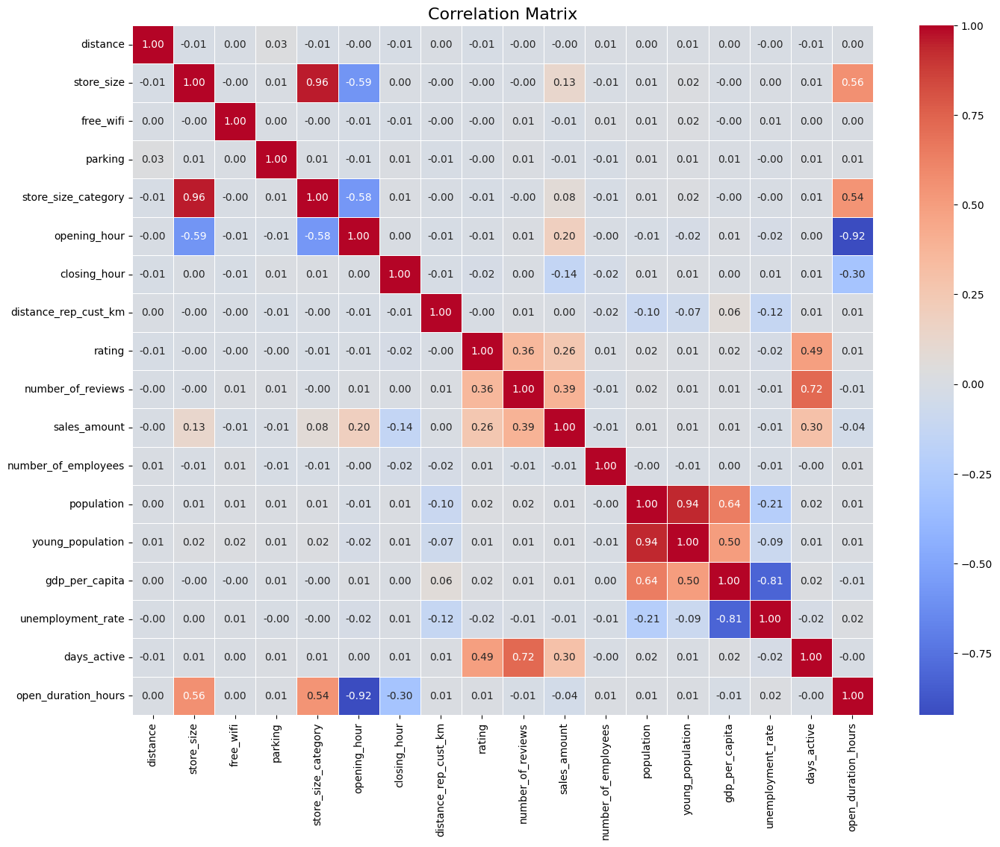

In [ ]:
#In the EDA we don't focused on the correlations, but for a first insight we wanted to see the correlations between our numerical features
corr = df_eda[numerical_features].corr()

plt.figure(figsize=(16, 12))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix', fontsize=16)
plt.show()


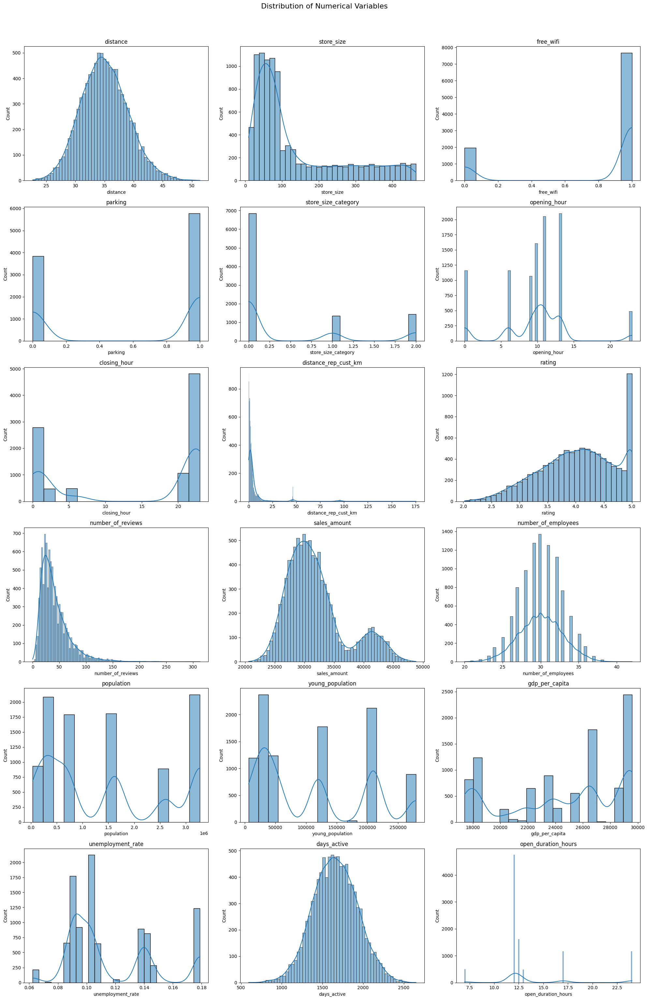

In [ ]:
fig, axes = plt.subplots(nrows=6, ncols=3, figsize=(20, 30))
fig.suptitle('Distribution of Numerical Variables', fontsize=16, y = 1.02)

for i, col in enumerate(numerical_features):
    sns.histplot(df_eda[col], ax=axes[i//3, i%3], kde=True)
    axes[i//3, i%3].set_title(col)

plt.tight_layout()
plt.show()

## Distribution Analysis

### Opening Hours
- **Observation**: The distribution has multiple peaks, suggesting stores open at various common hours.
  - **Peaks**: Noticeable around 6, 10, and 12.

### Distance to Customer (km)
- **Observation**: The distribution is skewed to the right, with a peak around 1 km.
  - **Additional Peaks**: Minor peaks at 2 and 4 km.

### Ratings
- **Observation**: Most ratings are high, between 4 and 5.
  - **Reliability**: This raises the question of how reliable the ratings are.

### Distance to Nearest Customer (km)
- **Observation**: The median distance is below 10 km.
  - **Outliers**: There are many outliers, with distances reaching up to 150 km.

### Number of Reviews
- **Observation**: The median number of reviews is very low.
  - **Outliers**: There are a few significant outliers, with some stores having up to 12,000 reviews.

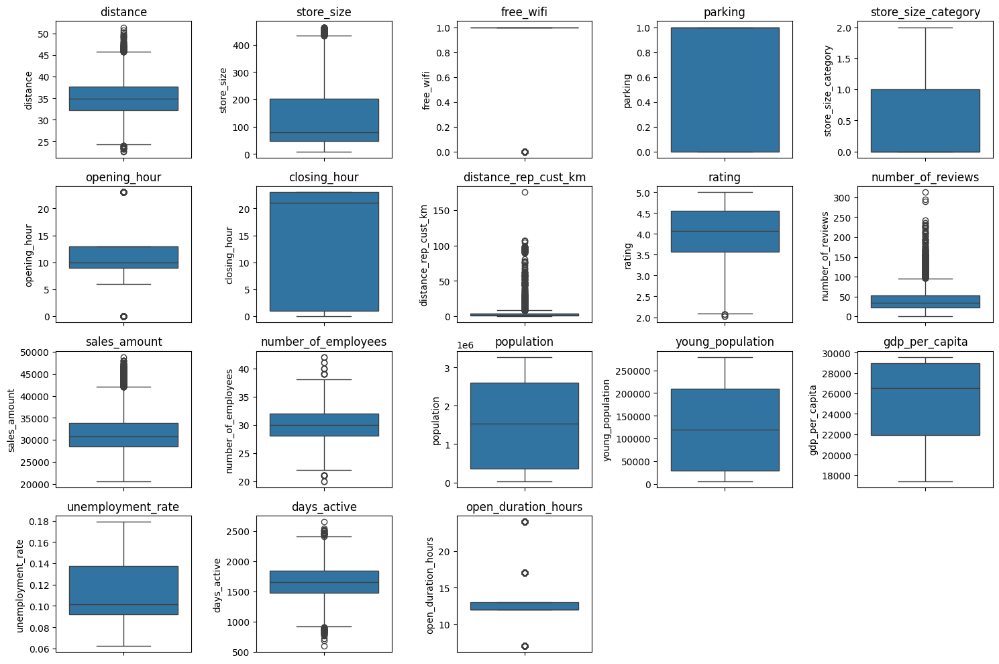

In [ ]:
plt.figure(figsize=(15, 10))
for i, col in enumerate(numerical_features, 1):
    plt.subplot(4, 5, i)
    sns.boxplot(y=df_eda[col])
    plt.title(col)
plt.tight_layout()
plt.show()

## Insights from Box Plots

### Distance
- **Distribution**: Approximately symmetrical.
- **Outliers**: Several outliers on both ends, with distances going below 25 and above 50.

### Distance to Nearest Customer (km)
- **Distribution**: Majority of values concentrated below 50 km.
- **Outliers**: Numerous outliers, with some distances reaching up to 150 km.

### Rating
- **Distribution**: Most ratings clustered between 3.5 and 5.
- **Outliers**: A few outliers below 3.

### Number of Reviews
- **Distribution**: Majority of stores have a low number of reviews.
- **Outliers**: Significant outliers, with some stores having up to 12,000 reviews.

### Sales Amount
- **Distribution**: Fairly symmetrical.
- **Outliers**: Some outliers above 45,000.

### Number of Employees
- **Distribution**: Number of employees ranges from 20 to 40.
- **Outliers**: Several outliers above 40.

### Days Active
- **Distribution**: Wide range.
- **Outliers**: Several outliers below 1000 and above 2500.

### Open Duration Hours
- **Distribution**: Majority of stores have similar open duration hours.
- **Outliers**: A few outliers below 10 and above 20.

# Geographical Insights

In [ ]:
sales_per_city = df_eda.groupby('city')['sales_amount'].sum().reset_index()
sales_per_city= sales_per_city.sort_values(by='sales_amount', ascending=False)
print(sales_per_city)

           city  sales_amount
7        Madrid  6.796582e+07
2     Barcelona  5.659851e+07
11      Sevilla  3.918568e+07
12     Valencia  2.847464e+07
1      Alicante  2.588909e+07
3        Bilbao  2.078417e+07
0      A Coruña  2.062037e+07
14     Zaragoza  1.778757e+07
13   Valladolid  8.622732e+06
5       Caceres  8.033543e+06
4        Burgos  6.766349e+06
10     Pamplona  3.401866e+06
6   Guadalajara  1.733048e+06
8        Murcia  1.000450e+06
9      Palencia  2.842522e+05


In [ ]:
#for visualization we created an interactive chart to understand the total sales_amount by city
fig = px.bar(sales_per_city, x='city', y='sales_amount',
             title='Total Sales Amount by City',
             labels={'city': 'City', 'sales_amount': 'Total Sales Amount'},
             color='sales_amount',
             color_continuous_scale='viridis')

fig.update_layout(xaxis_title='City', yaxis_title='Total Sales Amount',
                  template='plotly_white')

fig.show()

However, we cannot base ourselves on total sales, since some cities have more stores. So we need to focus on ratios to have more comparable insights to see which city has stores have a higher average annual sales.

In [ ]:
average_sales_per_city = df_eda.groupby('city')['sales_amount'].mean().sort_values(ascending=False).reset_index()
average_sales_per_city.columns = ['City', 'Average Sales Amount']

#Create the bar plot
fig = px.bar(average_sales_per_city, x='City', y='Average Sales Amount',
             title='Average Sales Amount per City',
             labels={'City': 'City', 'Average Sales Amount': 'Average Sales Amount'},
             color='Average Sales Amount',
             color_continuous_scale='viridis')

# Update the layout for better visualization
fig.update_layout(xaxis_title='City', yaxis_title='Average Sales Amount',
                  template='plotly_white', xaxis={'categoryorder':'total descending'})

# Display the figure
fig.show()


As we can see, Guadalajara has the highest average sales, however we first need to check the amount of stores already open and connect this with sociademographic information to see if it make sense to expand to city regardless the high average sales.




In [ ]:
#Calculate the number of stores per city
stores_per_city = df_eda['city'].value_counts().reset_index()
stores_per_city.columns = ['City', 'Number of Stores']

print(stores_per_city)

           City  Number of Stores
0        Madrid              2125
1     Barcelona              1775
2       Sevilla              1235
3      Valencia               892
4      Alicante               817
5        Bilbao               653
6      A Coruña               647
7      Zaragoza               555
8    Valladolid               266
9       Caceres               252
10       Burgos               215
11     Pamplona               106
12  Guadalajara                53
13       Murcia                32
14     Palencia                 9


In [ ]:
#Number of stores per city
fig = px.bar(stores_per_city, x='City', y='Number of Stores',
             title='Number of Stores per City',
             labels={'City': 'City', 'Number of Stores': 'Number of Stores'},
             color='Number of Stores',
             color_continuous_scale='viridis')

fig.update_layout(xaxis_title='City', yaxis_title='Number of Stores',
                  template='plotly_white', xaxis_tickangle=-45)

fig.show()

Even though Guadalajara is the city with the highest average sales amount, it is one of the cities with the lowest number of stores. So we need to analyse if it make sense to expand there.

In [ ]:
socio_features = ['population','gdp_per_capita', 'young_population', 'unemployment_rate','average_sales_per_day', 'sales_amount']

Sicne our product is popular among young consumers, between 16 and 25 years old we wanted to compared the potential of young population.

In [ ]:
#Since young population by itself doesn't mean anything, we decided to create young population ratio
df_eda['young_population_rate'] = df_eda['young_population'] / df_eda['population']
young_population_rate_per_city = df_eda.groupby('city')['young_population_rate'].mean().sort_values(ascending=False).reset_index()



fig = px.bar(young_population_rate_per_city, x='city', y='young_population_rate',
             title='Young Population Rate per City',
             labels={'city': 'City', 'young_population_rate': 'Young Population Rate'},
             color='young_population_rate',
             color_continuous_scale='viridis')


fig.update_layout(xaxis_title='City', yaxis_title='Young Population Rate',
                  template='plotly_white', xaxis_tickangle=-45)

fig.show()

In [ ]:
population_per_city = df_eda.groupby('city')['population'].mean().sort_values(ascending=False).reset_index()

fig = px.bar(population_per_city, x='city', y='population',
             title='Population per City',
             labels={'city': 'City', 'population': 'Population'},
             color='population',
             color_continuous_scale='viridis')


fig.update_layout(xaxis_title='City', yaxis_title='Population',
                  template='plotly_white', xaxis_tickangle=-45)

fig.show()

The total population and the number of stores in a city significantly impact potential business expansion. For instance, a city like Madrid with a large population might already have many customers, covering most of the market. Consequently, there might be fewer potential sales to gain compared to other cities with fewer stores relative to their population. To better understand the market potential, we calculate the population coverage per store for each city. This metric helps identify cities with a higher population per store ratio, indicating greater opportunities for new store openings.

In [ ]:
#Recreating the variables without sorting already
stores_per_city = df_eda['city'].value_counts()
population_per_city = df_eda.groupby('city')['population'].mean()

# Calculating the population coverage per store for each city
population_per_store = (population_per_city / stores_per_city).sort_values(ascending=False).reset_index()
population_per_store.columns = ['City', 'Population per Store']

fig = px.bar(population_per_store, x='City', y='Population per Store',
             title='Population per Store per City',
             labels={'City': 'City', 'Population per Store': 'Population per Store'},
             color='Population per Store',
             color_continuous_scale='viridis')

fig.update_layout(xaxis_title='City', yaxis_title='Population per Store',
                  template='plotly_white', xaxis_tickangle=-45)

fig.show()


In [ ]:
import plotly.express as px

# Assuming df_eda has 'unemployment_rate' as a ratio already, so no need for conversion
# Calculate average unemployment rate per city and sort the values
unemployment_per_city = df_eda.groupby('city')['unemployment_rate'].mean().sort_values(ascending=False).reset_index()

# Create a bar plot for unemployment rate per city
fig = px.bar(unemployment_per_city, x='city', y='unemployment_rate',
             title='Unemployment Rate per City',
             labels={'city': 'City', 'unemployment_rate': 'Unemployment Rate (Ratio)'},
             color='unemployment_rate',
             color_continuous_scale='viridis')

# Update the layout for better visualization
fig.update_layout(xaxis_title='City', yaxis_title='Unemployment Rate (Ratio)',
                  template='plotly_white', xaxis_tickangle=-45)

# Set the category order to descending based on total values
fig.update_xaxes(categoryorder='total descending')

# Show the plot
fig.show()


In [ ]:
import plotly.express as px

# Calculate average GDP per capita per city and sort the values
gdp_per_city = df_eda.groupby('city')['gdp_per_capita'].mean().sort_values(ascending=False).reset_index()

# Create a bar plot for GDP per capita per city
fig = px.bar(gdp_per_city, x='city', y='gdp_per_capita',
             title='GDP per Capita per City',
             labels={'city': 'City', 'gdp_per_capita': 'GDP per Capita'},
             color='gdp_per_capita',
             color_continuous_scale='viridis')

# Update the layout for better visualization
fig.update_layout(xaxis_title='City', yaxis_title='GDP per Capita',
                  template='plotly_white', xaxis_tickangle=-45)

# Set the category order to descending based on total values
fig.update_xaxes(categoryorder='total descending')

# Show the plot
fig.show()

## Besides finding our best cutomer based on location, we also want to deepdive

*   Élément de liste
*   Élément de liste

in the kind of store as our best customer

Deepdive into the store size

In [ ]:
fig = px.scatter(df_eda, x='store_size', y='sales_amount',
                 title='Store Size vs Sales Amount',
                 labels={'store_size': 'Store Size', 'sales_amount': 'Sales Amount'},
                 color='sales_amount',
                 color_continuous_scale='viridis',
                 trendline='ols')

fig.update_layout(xaxis_title='Store Size', yaxis_title='Sales Amount',
                  template='plotly_white')

fig.show()


Although there is a positive correlation, it is quite minor, with the line being close to flat and continuous.. as smaller store sizes have closely comparable sales amount to large ones despite being significantly smaller**
**i.e: Stores with sizes between 0 & 100 are in the same range of sales than stores of sizes between 300 & 400 (or even 400 above), all being in sales range between 30,000 and 35,000

In [ ]:
#We binned the stores into 0=small, 1=medium, 2=large
#Calculate the average sales amount per store size category and sort by sales amount in descending order
avg_sales_per_category = df_eda.groupby('store_size_category')['sales_amount'].mean().sort_values(ascending=False).reset_index()

fig = px.bar(avg_sales_per_category, x='store_size_category', y='sales_amount',
             title='Average Sales Amount per Store Size Category',
             labels={'store_size_category': 'Store Size Category', 'sales_amount': 'Average Sales Amount'},
             color='sales_amount',
             color_continuous_scale='viridis')

fig.update_layout(xaxis_title='Store Size Category', yaxis_title='Average Sales Amount',
                  template='plotly_white', xaxis_tickangle=-45,
                  xaxis={'categoryorder':'total descending'})

fig.show()




0 = small
1 = medium
2 = large

In [ ]:
#Calculate the average sales amount by store size category
total_sales_by_category = df_eda.groupby('store_size_category')['sales_amount'].mean().reset_index()

fig = px.pie(total_sales_by_category, values='sales_amount', names='store_size_category',
             title='Average Sales Amount by Store Size Category',
             color_discrete_sequence=px.colors.sequential.Plasma)

fig.update_traces(textposition='inside', textinfo='percent+label')

fig.update_layout(template='plotly_white')

fig.show()

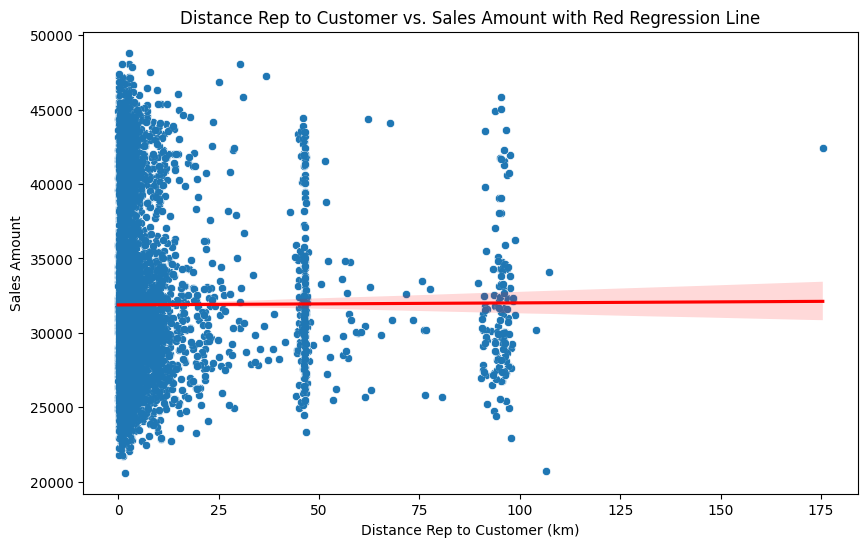

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='distance_rep_cust_km', y='sales_amount', data=df_eda)
sns.regplot(x='distance_rep_cust_km', y='sales_amount', data=df_eda, scatter_kws={'s':10}, line_kws={'color': 'red'})
plt.title('Distance Rep to Customer vs. Sales Amount with Red Regression Line')
plt.xlabel('Distance Rep to Customer (km)')
plt.ylabel('Sales Amount')
plt.show()


Flat regression line : Distance has little to no impact. Also makes sense taking into account the distribution we saw above of the distance variable - most distances are between 2km and 4km

# Chronological insights

In [ ]:

bins = [-1, 6, 12, 18, 24]
labels = ['Late Night', 'Morning', 'Afternoon', 'Evening']

# Bin the opening and closing hours
df_eda['opening_bin'] = pd.cut(df_eda['opening_hour'], bins=bins, labels=labels, right=False)
df_eda['closing_bin'] = pd.cut(df_eda['closing_hour'], bins=bins, labels=labels, right=False)

# Combine the binned opening and closing hours
df_eda['time_period'] = df_eda['opening_bin'].astype(str) + ' to ' + df_eda['closing_bin'].astype(str)

df_eda[['opening_hour', 'opening_bin', 'closing_hour', 'closing_bin', 'time_period']]


,opening_hour,opening_bin,closing_hour,closing_bin,time_period
0,23,Evening,6,Morning,Evening to Morning
1,13,Afternoon,1,Late Night,Afternoon to Late Night
2,11,Morning,23,Evening,Morning to Evening
3,6,Morning,23,Evening,Morning to Evening
4,6,Morning,23,Evening,Morning to Evening
...,...,...,...,...,...
9627,13,Afternoon,1,Late Night,Afternoon to Late Night
9628,6,Morning,23,Evening,Morning to Evening
9629,0,Late Night,0,Late Night,Late Night to Late Night
9630,9,Morning,21,Evening,Morning to Evening


<ipython-input-81-41238782e3db>:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




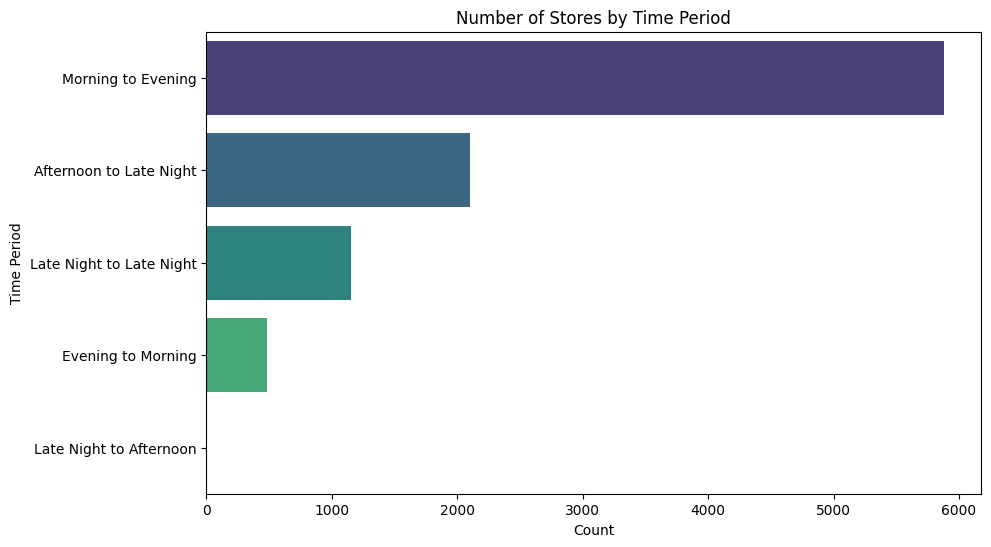

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Count the number of stores in each time period
time_period_counts = df_eda['time_period'].value_counts().reset_index()
time_period_counts.columns = ['time_period', 'count']

# Plotting the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x='count', y='time_period', data=time_period_counts, palette='viridis')

plt.xlabel('Count')
plt.ylabel('Time Period')
plt.title('Number of Stores by Time Period')
plt.show()


In [ ]:
# Group by 'time_period' and calculate the average sales amount
average_sales_time_period = df_eda.groupby('time_period')['sales_amount'].mean().reset_index()

fig = px.bar(average_sales_time_period, x='time_period', y='sales_amount',
             title='Average Sales Amount per Time Period',
             labels={'time_period': 'Time Period', 'sales_amount': 'Average Sales Amount'},
             color='sales_amount',
             color_continuous_scale='viridis',
             category_orders={'time_period': average_sales_time_period.sort_values('sales_amount', ascending=False)['time_period']})

fig.update_layout(xaxis_title='Time Period', yaxis_title='Average Sales Amount',
                  template='plotly_white', xaxis_tickangle=-45)

fig.show()


In [ ]:
result = df_eda.groupby(['time_period']).agg({'sales_amount': 'mean'}).reset_index()
result = result.sort_values(by='sales_amount', ascending=False).reset_index(drop=True)
print(result)

                time_period  sales_amount
0        Evening to Morning  41555.866335
1   Late Night to Afternoon  40493.077142
2  Late Night to Late Night  32546.513397
3   Afternoon to Late Night  31475.430058
4        Morning to Evening  31104.752757


Analysis on open duration hours

In [ ]:
fig = px.scatter(df_eda, x='open_duration_hours', y='sales_amount',
                 title='Sales Amount vs. Open Duration Hours',
                 labels={'open_duration_hours': 'Open Duration Hours', 'sales_amount': 'Sales Amount'},
                 color='sales_amount',
                 color_continuous_scale='viridis')

# Update the layout for better visualization
fig.update_layout(xaxis_title='Open Duration Hours', yaxis_title='Sales Amount',
                  template='plotly_white')

# Display the figure
fig.show()



In [ ]:
fig = px.scatter(df_eda, x='days_active', y='sales_amount',
                 title='Scatter Plot of Days Active vs Sales Amount',
                 labels={'days_active': 'Days Active', 'sales_amount': 'Sales Amount'},
                 color='sales_amount',
                 color_continuous_scale='viridis',
                 trendline='ols')

fig.update_layout(xaxis_title='Days Active', yaxis_title='Sales Amount',
                  template='plotly_white')


fig.show()

In [ ]:
#Sales amount over time
df_eda['date_opening'] = pd.to_datetime(df_eda['date_opening'])
sales_over_time = df_eda.groupby('date_opening')['sales_amount'].mean().reset_index()

fig = px.line(sales_over_time, x='date_opening', y='sales_amount',
              title='Sales Amount Over Time',
              labels={'date_opening': 'Date Opening', 'sales_amount': 'Total Sales Amount'})


fig.update_xaxes(tickangle=45)


fig.show()

# Customer types

In [ ]:
fig = go.Figure()

fig.add_trace(go.Scatter(x=df_eda['rating'], y=df_eda['sales_amount'], mode='markers',
                         marker=dict(size=10, opacity=0.5),
                         name='Sales vs Ratings'))

slope, intercept = np.polyfit(df_eda['rating'], df_eda['sales_amount'], 1)

fig.add_trace(go.Scatter(x=df_eda['rating'], y=slope*df_eda['rating'] + intercept,
                         mode='lines', line=dict(color='red'),
                         name='Regression Line'))


fig.update_layout(title='Scatter Plot of Ratings vs Sales Amount with Regression Line',
                  xaxis_title='Rating',
                  yaxis_title='Sales Amount',
                  width=1000, height=600)

fig.show()

## Fluctuations

There are significant fluctuations in the average number of reviews for lower young population values. This suggests variability in reviews among locations with smaller young populations.

## Trend

As the young population increases, there is a general upward trend in the average number of reviews, especially after 200,000. This indicates that locations with larger young populations tend to have higher average reviews.

## Stability

There is a relatively stable range of average reviews for young populations between 50,000 and 150,000.


**Again, a lot of fluctuations, making us unable to make clear assumptions or insights on trends regarding a possible relationship between youngsters and sales amount of BeverageCo. The information provided and statements made in the documents apart from the dataset may be outdated...**

<ipython-input-88-594151dcd4c9>:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




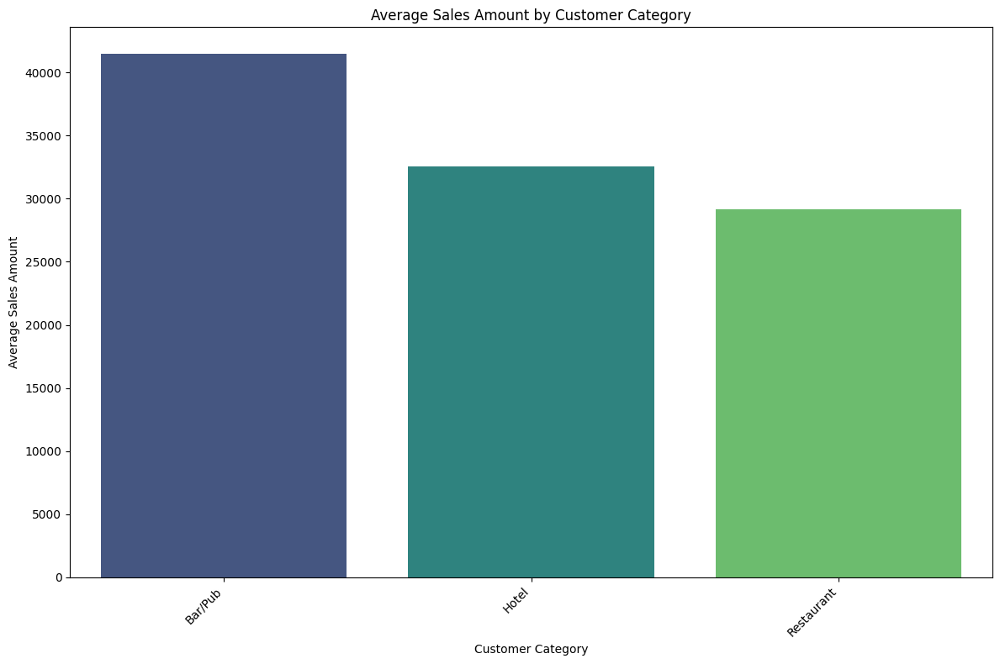

In [ ]:
average_sales_by_customer_category = df_eda.groupby('customer_category')['sales_amount'].mean().reset_index()

# Rename columns for clarity
average_sales_by_customer_category.columns = ['Customer Category', 'Average Sales Amount']

# Plotting the average sales amount per customer category
plt.figure(figsize=(12, 8))
sns.barplot(x='Customer Category', y='Average Sales Amount', data=average_sales_by_customer_category, palette='viridis')
plt.xlabel('Customer Category')
plt.ylabel('Average Sales Amount')
plt.title('Average Sales Amount by Customer Category')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()



In [ ]:

fig = px.scatter(df_eda, x='number_of_employees', y='sales_amount',
                 labels={'number_of_employees': 'Number of Employees', 'sales_amount': 'Sales Amount'},
                 title='Number of Employees vs. Sales Amount with Regression Line',
                 trendline='ols',
                 width=1000, height=600)


fig.update_layout(
    plot_bgcolor='rgba(255, 255, 255, 1)',
    paper_bgcolor='rgba(255, 255, 255, 1)',
)

fig.show()


**The regression line is flat, meaning there is no particular correlation (positive or negative) between amount of employees and sales
--> Makes sense since some bars/pubs have similar avg sales to large resorts**

In [ ]:
correlation_matrix = df_eda[numerical_features].corr()

correlation_with_sales = correlation_matrix['sales_amount'].drop('sales_amount')

print(correlation_with_sales.sort_values(ascending=False))


number_of_reviews       0.390195
days_active             0.299720
rating                  0.258626
opening_hour            0.195618
store_size              0.126295
store_size_category     0.075384
gdp_per_capita          0.013849
population              0.011048
young_population        0.009025
distance_rep_cust_km    0.003701
distance               -0.003999
parking                -0.005893
number_of_employees    -0.007011
free_wifi              -0.009141
unemployment_rate      -0.013242
open_duration_hours    -0.043303
closing_hour           -0.141639
Name: sales_amount, dtype: float64


In [ ]:
avg_sales_by_parking = df_eda.groupby('parking')['sales_amount'].mean().reset_index()

fig = px.bar(avg_sales_by_parking, x='parking', y='sales_amount',
             labels={'parking': 'Parking', 'sales_amount': 'Average Sales Amount'},
             title='Average Sales Amount by Parking Availability',
             template='plotly_white')

fig.update_layout(
    xaxis_title='Parking',
    yaxis_title='Average Sales Amount',
    plot_bgcolor='rgba(255, 255, 255, 1)',
    paper_bgcolor='rgba(255, 255, 255, 1)',
    width=1000, height=600
)

fig.show()


**The store having parking or not does not particularly affect sales in one way or another**

In [ ]:
avg_sales_by_wifi = df_eda.groupby('free_wifi')['sales_amount'].mean().reset_index()

fig = px.bar(avg_sales_by_wifi, x='free_wifi', y='sales_amount',
             labels={'free_wifi': 'Free WiFi', 'sales_amount': 'Average Sales Amount'},
             title='Average Sales Amount by WiFi Availability')

fig.update_layout(
    xaxis_title='Free WiFi',
    yaxis_title='Average Sales Amount',
    plot_bgcolor='rgba(255, 255, 255, 1)',
    paper_bgcolor='rgba(255, 255, 255, 1)',
    width=1000, height=600
)

fig.show()


**The store having free WiFi or not does not particularly affect sales in one way or another**

In [ ]:

# encode 'parking' and 'free_wifi' to numerical
df_eda['parking'] = df_eda['parking'].astype(int)
df_eda['free_wifi'] = df_eda['free_wifi'].astype(int)

correlation_parking_wifi = df_eda[['sales_amount', 'parking', 'free_wifi']].corr()

correlation_with_sales = correlation_parking_wifi['sales_amount'].sort_values(ascending=False)

print(correlation_with_sales)


sales_amount    1.000000
parking        -0.005893
free_wifi      -0.009141
Name: sales_amount, dtype: float64


**As we can see, the categorical features parking and wifi don't affect sales consequently**

to be continued and improved...

# Profile of a Best Customer based on insights - Conclusions for first segmentations and clusterings

## 1. Average Sales per City vs total sales and days active
- **Insight**: Focus on cities with higher average sales, as we have seen that focusing on total sales amount and days active may distort the view.

## 3. Opening Hours
- **Insight**: Stores that open during specific time periods show different sales performances.
- **Conclusion**: Stores that have extended opening hours, especially those open during peak hours, tend to perform better. Ensuring that stores remain open during these profitable hours can attract more customers and increase sales.
We saw that stores open late at night (from evening to morning) tend to have more sales of BeverageCo, regardless of the city.

## 4. Customer Category 1 & 2
- **Insight**: Different customer categories contribute differently to sales amounts.
- **Conclusion**: We saw that restaurants; hotels and pubs are the most present in the top performing customers. It might be interesting to merge some categories together like hotels and resorts, as they have similar relationships with the target variable.
Restaurants are usually not the biggest 'stores'/institutions in the dataset, which explains why the "Small" category size compete well with medium and large stores.
Pubs/bars generally are also often small, and have less employees than most other types of stores, but have good sales, which explains some of the insights and visualizations above.

## 5. Distance to Nearest Customer
- **Insight**: Distance does not significantly affect sales amounts, but there are high densities of customers at certain distances.

## 7. Number of Reviews and Ratings
- **Insight**: Stores with higher ratings and more reviews tend to have higher sales.
- **Conclusion**: Encouraging customers to leave positive reviews and ratings can enhance a store’s reputation and attract more business.
You population do not leave particulary higher ratings than population groups. As we see in the correlation matrixes, the correlation between young population rate and the target variable is close to inexistant.


In [ ]:
df_eda = pd.concat([stored_columns, df_eda], axis=1)


In [ ]:
df_eda.to_csv(output_dir + "/eda_cleaned.csv", index=False)

In [ ]:
df_eda

,sales_representative_id,id,latitude,longitude,sales_representative_latitude,sales_representative_longitude,distance,city,store_size,free_wifi,...,population,young_population,gdp_per_capita,unemployment_rate,days_active,open_duration_hours,young_population_rate,opening_bin,closing_bin,time_period
0,22,2.0,43.351256,-8.410301,43.362927,-8.402358,31.681670,A Coruña,122.1635,1,...,246047,29526,21898,0.1092,1413,7.0,0.120001,Evening,Morning,Evening to Morning
1,10,3.0,43.255756,-2.939133,43.262941,-2.935849,29.656813,Bilbao,71.1614,1,...,353187,27195,28618,0.0928,1721,12.0,0.076999,Afternoon,Late Night,Afternoon to Late Night
2,15,4.0,38.354208,-0.505718,38.300530,-0.604413,31.277988,Alicante,75.7135,1,...,33441,6153,17405,0.1413,1719,12.0,0.183996,Morning,Evening,Morning to Evening
3,29,5.0,40.463496,-3.635538,40.453918,-3.654711,38.071841,Madrid,215.2493,1,...,3273049,209475,29576,0.1018,1731,17.0,0.064000,Morning,Evening,Morning to Evening
4,8,6.0,39.472037,-6.371697,39.474834,-6.363447,38.649910,Caceres,252.1306,0,...,387805,36668,20354,0.1478,2025,17.0,0.094553,Morning,Evening,Morning to Evening
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9627,23,9994.0,40.399515,-3.696936,40.403571,-3.697315,35.362156,Madrid,45.0565,0,...,3273049,209475,29576,0.1018,1947,12.0,0.064000,Afternoon,Late Night,Afternoon to Late Night
9628,23,9995.0,40.398334,-3.697031,40.403571,-3.697315,33.621825,Madrid,287.1539,1,...,3273049,209475,29576,0.1018,1912,17.0,0.064000,Morning,Evening,Morning to Evening
9629,5,9996.0,43.243966,-2.896762,43.245405,-2.910147,35.763547,Bilbao,355.0638,1,...,353187,27195,28618,0.0928,1851,24.0,0.076999,Late Night,Late Night,Late Night to Late Night
9630,3,9997.0,41.416983,2.197787,41.426438,2.176616,25.767590,Barcelona,377.1740,1,...,1619337,119831,26531,0.0918,1276,12.0,0.074000,Morning,Evening,Morning to Evening
